In [177]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from sklearn.linear_model import LinearRegression
import numpy as np


In [178]:
#clean all student dataset and calculate percentage
data = pd.read_excel('./data/artcourse.xlsx')
data.columns = data.iloc[0]
data = data[1:]

In [179]:
data['All Grades'] = data['All Grades'].str.replace(',', '').str.strip().astype(int)
data['Total Students'] = data['Total Students'].str.replace(',', '').str.strip().astype(int)

data['All_Percentage'] = data['All Grades'] / data['Total Students']
data.head()

,District Name,District Code,K,01,02,03,04,05,06,07,08,09,10,11,12,All Grades,Total Students,All_Percentage
1,Abby Kelley Foster Charter Public (District),04450000,120,118,117,119,120,123,120,110,42,63,0,14,20,1086,1421,0.764251
2,Abington,00010000,0,0,0,0,0,0,0,173,158,29,32,30,51,473,2109,0.224277
3,Academy Of the Pacific Rim Charter Public (Dis...,04120000,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,10,17,27,497,0.054326
4,Acton-Boxborough,06000000,0,0,0,0,0,0,0,386,405,95,96,35,90,1107,5124,0.216042
5,Acushnet,00030000,78,102,86,119,100,80,112,104,99,NaN,NaN,NaN,NaN,880,880,1.000000


In [180]:
#clean low income dataset and calculate percentage
low_income = pd.read_excel('./data/lowincome.xlsx')
low_income.columns = low_income.iloc[0]
low_income = low_income[1:]

low_income['All Grades'] = low_income['All Grades'].str.replace(',', '').fillna(-1)
low_income['All Grades'] = low_income['All Grades'].astype(int)
#print(low_income['All Grades'])
low_income['Total Students'] = low_income['Total Students'].fillna(-1).str.replace(',', '').str.strip().astype(int)

low_income['low_income_Percentage'] = low_income['All Grades'] / low_income['Total Students']

'''
the percentage here is suggesting the ratio of student exposed to CS course in low income group
'''
low_income.head()


,District Name,District Code,K,01,02,03,04,05,06,07,08,09,10,11,12,All Grades,Total Students,low_income_Percentage
1,Abby Kelley Foster Charter Public (District),04450000,94,98,86,84,88,90,78,75,27,44,0,6,15,785,1002,0.783433
2,Abington,00010000,0,0,0,0,0,0,0,76,68,11,15,9,14,193,882,0.218821
3,Academy Of the Pacific Rim Charter Public (Dis...,04120000,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,5,6,11,331,0.033233
4,Acton-Boxborough,06000000,0,0,0,0,0,0,0,44,51,8,5,9,4,121,614,0.197068
5,Acushnet,00030000,23,52,42,52,40,30,33,43,31,NaN,NaN,NaN,NaN,346,346,1.000000


In [181]:
data.columns
data = data[['District Name', 'District Code','All Grades',
       'Total Students', 'All_Percentage']]
low_income.columns
low_income = low_income[['District Name', 'District Code','All Grades',
       'Total Students', 'low_income_Percentage']]

###since now we have the amount of low_income student and all the student
###we can try to see which school district has the highest percentage of low_income group 
###and how it relate to the exposure of computer science
###if income does not make a difference --> accessibility --> # of NGO in each school district

In [182]:
##at this steop: maybe combine the lower income and all student data is a good idea
##but first let's just rename the column for identification purpose

data = data.rename(columns={'All Grades': 'as_all_grades', 'Total Students': 'as_total_student'})
low_income = low_income.rename(columns={'All Grades': 'low_all_grades', 'Total Students': 'low_total_student'})

comp_low_n_all = pd.merge(data,low_income, how='inner', on='District Code')

comp_low_n_all = comp_low_n_all.drop(columns=['District Name_y'])

###now, we can try to see which school district has the highest percentage of low income student
comp_low_n_all['%low_All'] = comp_low_n_all['low_total_student'] / comp_low_n_all['as_total_student']
relation = comp_low_n_all[['District Name_x','%low_All', 'All_Percentage']].sort_values('%low_All')
relation.to_excel('./result_comparison.xlsx', index=False)
relation.head()

,District Name_x,%low_All,All_Percentage
195,Ma Academy for Math and Science,0.032967,0.791209
93,Dover,0.041408,1.000000
64,Carlisle,0.054276,0.000000
94,Dover-Sherborn,0.062661,0.615451
261,Norwell,0.066077,0.506282


/var/folders/yw/b9nlzwns0h35ngrgtc6rc9xr0000gn/T/ipykernel_82920/605138959.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  preMerProcess_data['ORG8CODE'] = preMerProcess_data['ORG8CODE'].fillna(0).astype(int)


<AxesSubplot:>

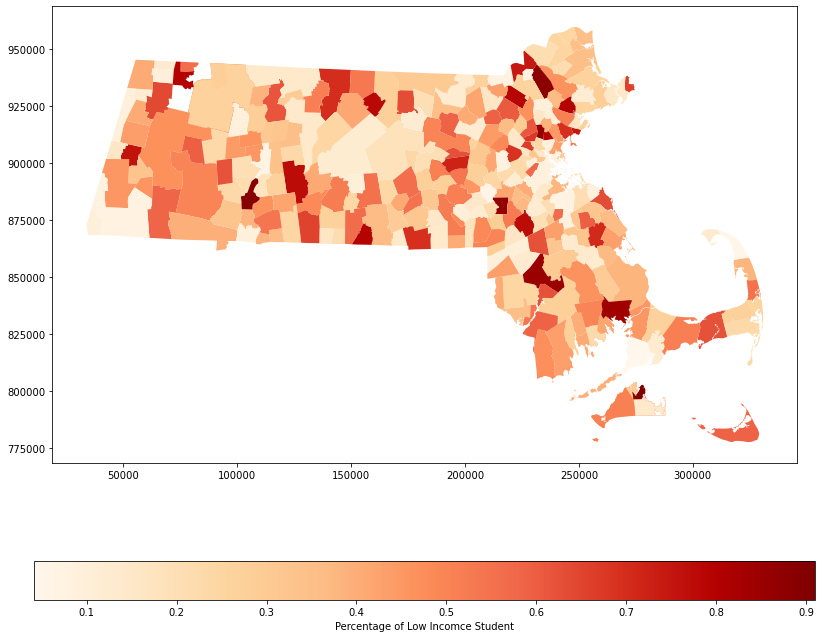

In [183]:
##we can even make a map for this base on the percentage of low_income people
geo_info = gpd.read_file('./data/schooldistricts/SCHOOLDISTRICTS_POLY.shp')

'''
testing code
    geo_info.plot(facecolor='white', edgecolor='red', figsize=(12, 10))
    plt.show()

'''

# Merge the two datasets by Code
preMerProcess_data = geo_info[['ORG4CODE', 'ORG8CODE', 'DISTRICT_N']]
preMerProcess_data['ORG8CODE'] = preMerProcess_data['ORG8CODE'].fillna(0).astype(int)
comp_low_n_all['District Code'] = comp_low_n_all['District Code'].fillna(0).astype(int)
preMerProcess_data = preMerProcess_data.rename(columns={'ORG8CODE': 'District Code'})

map_data = pd.merge(preMerProcess_data, comp_low_n_all, on='District Code')


geometry = geo_info['geometry']

mapping_data_clean = gpd.GeoDataFrame(map_data,geometry=geometry)
mapping_data_clean.plot(figsize=(14,12), 
                        column='%low_All',
                        cmap='OrRd',
                        legend=True,legend_kwds = {"label": "Percentage of Low Incomce Student", "orientation": "horizontal"})



In [184]:
##advance interative map for that
mapping_data_clean = mapping_data_clean[['District Code', 'District Name_x', '%low_All', 'All_Percentage','geometry']]
mapping_data_clean = mapping_data_clean.rename(columns={'%low_All': 'Percentage of Low Income Student',
                                                        'All_Percentage': 'Percentage of Student expose to CS courses'})
mapping_data_clean.explore(
    column = 'Percentage of Student expose to CS courses',
    cmap='OrRd',
    #tooltip = 'District Name_x',
    #popup = True
    #style_kwds=dict(color="black")
)



Coefficient (slope): -0.21938598067602616
Intercept: 0.4814601209452647
R^2: 0.02570687535833005


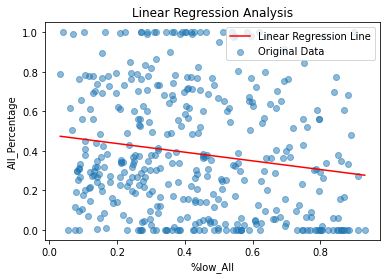

In [185]:
x = relation['%low_All']
y = relation['All_Percentage']

# Reshape the input data
x = np.array(x).reshape(-1, 1)

# Create and fit the linear regression model
model = LinearRegression()
model.fit(x, y)

# Print the coefficients and intercept
print('Coefficient (slope):', model.coef_[0])
print('Intercept:', model.intercept_)

# Predict the output for the input data
y_pred = model.predict(x)

# Calculate the coefficient of determination (R^2)
r2 = model.score(x, y)
print('R^2:', r2)

# Plot the original data and the regression line
plt.scatter(x, y, alpha=0.5, label='Original Data')
plt.plot(x, y_pred, color='red', label='Linear Regression Line')
plt.xlabel('%low_All')
plt.ylabel('All_Percentage')
plt.title('Linear Regression Analysis')
plt.legend()

# Display the plot
plt.show()


In [186]:
###this can lead into on other question: would our data inclusive enough for income level? 
###Should we need more income data with respect to school district?
###still keeps this question, and need to discuss with teammates tomorrow

###

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Create a binary target variable indicating whether the trend is followed or not
relation['Trend_Followed'] = (relation['%low_All'] > 0.5) & (relation['All_Percentage'] < 0.5)

# Split the data into training and testing sets
X = relation[['%low_All', 'All_Percentage']]
y = relation['Trend_Followed']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

# Train a logistic regression model
model = LogisticRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the accuracy of the model
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy: {:.2f}%".format(accuracy * 100))


Accuracy: 93.50%


In [187]:
###Now, we can focus more the accessibility side --> # of NGO in each county
###I think we can do that!

In [188]:
### this block is to get info about general NGO
'''
import requests
import json
from tqdm import tqdm

# Define the base URL
base_url = 'https://projects.propublica.org/nonprofits/api/v2/search.json?q=&state%5Bid%5D=MA&ntee%5Bid%5D=2&c_code%5Bid%5D=3&page='
all_organizations = []

for page in tqdm(range(54), desc="Processing Pages"):
    url = base_url + str(page)
    response = requests.get(url)

    if response.status_code == 200:
        data = response.json()
        organizations = data['organizations']

        all_organizations.extend(organizations)
    else:
        print(f"Error occurred while accessing page {page+1}.")


file_path = './data/all_organizations.json'

# Write the combined data to the file
with open(file_path, 'w') as file:
    json.dump(all_organizations, file)

print(f"All data has been successfully saved to {file_path}.")
'''


'\nimport requests\nimport json\nfrom tqdm import tqdm\n\n# Define the base URL\nbase_url = \'https://projects.propublica.org/nonprofits/api/v2/search.json?q=&state%5Bid%5D=MA&ntee%5Bid%5D=2&c_code%5Bid%5D=3&page=\'\nall_organizations = []\n\nfor page in tqdm(range(54), desc="Processing Pages"):\n    url = base_url + str(page)\n    response = requests.get(url)\n\n    if response.status_code == 200:\n        data = response.json()\n        organizations = data[\'organizations\']\n\n        all_organizations.extend(organizations)\n    else:\n        print(f"Error occurred while accessing page {page+1}.")\n\n\nfile_path = \'./data/all_organizations.json\'\n\n# Write the combined data to the file\nwith open(file_path, \'w\') as file:\n    json.dump(all_organizations, file)\n\nprint(f"All data has been successfully saved to {file_path}.")\n'

In [189]:
### this block is to get info about detailed NGO
'''
org = pd.read_json('./data/all_organizations.json')

org.columns
##output data frist
org_res = org[['name', 'sub_name', 'city', 'state']]
org_res.to_excel('./ngo_by_town.xlsx', index=True)


##getting more detailed data about each NGO
org_id = org['ein'].to_list()
organizations_details = []

for org_info in tqdm(org_id, desc="Processing Organizations"):
    url = 'https://projects.propublica.org/nonprofits/api/v2/organizations/' + str(org_info) +'.json'

    response = requests.get(url)

    if response.status_code == 200:
        data = response.json()
        organizations = data['organization']

        organizations_details.append(organizations)
    else:
        print(f"Error occurred while accessing page {org_info+1}.")


file_path = './data/organizations_detail.json'

# Write the combined data to the file
with open(file_path, 'w') as file:
    json.dump(organizations_details, file)

print(f"All data has been successfully saved to {file_path}.")
'''


'\norg = pd.read_json(\'./data/all_organizations.json\')\n\norg.columns\n##output data frist\norg_res = org[[\'name\', \'sub_name\', \'city\', \'state\']]\norg_res.to_excel(\'./ngo_by_town.xlsx\', index=True)\n\n\n##getting more detailed data about each NGO\norg_id = org[\'ein\'].to_list()\norganizations_details = []\n\nfor org_info in tqdm(org_id, desc="Processing Organizations"):\n    url = \'https://projects.propublica.org/nonprofits/api/v2/organizations/\' + str(org_info) +\'.json\'\n\n    response = requests.get(url)\n\n    if response.status_code == 200:\n        data = response.json()\n        organizations = data[\'organization\']\n\n        organizations_details.append(organizations)\n    else:\n        print(f"Error occurred while accessing page {org_info+1}.")\n\n\nfile_path = \'./data/organizations_detail.json\'\n\n# Write the combined data to the file\nwith open(file_path, \'w\') as file:\n    json.dump(organizations_details, file)\n\nprint(f"All data has been successfully

In [190]:
detail_org_data = pd.read_json('./data/organizations_detail.json')
#print(detail_org_data.columns)
detail_org_data = detail_org_data[['name','income_amount', 'revenue_amount','city', 'state']]
detail_org_data.head()

###recap: we can to do quantity analysis first --> group NGO by city and check the number of NGO in one specific city
city_counts = detail_org_data.groupby('city').size().reset_index(name='Number of NGO')

###read the dataset with percentage and join them

##Sorry, Laya the dataset you sent me is problematic on my side.....
##complete_percent_city = pd.read_csv('./data/by_city_percent.csv',error_bad_lines=False)
#complete_percent_city.head()




detail_org_data.to_excel('./result_detailed_org.xlsx')

In [191]:
###lets use the original dateset I have again --> this mapping_data_clean is merge base on the school district
###this time we probably want to map the district into city
###so, we have to manipulate the data again

###by doing so, we need new dataset and the data need to be in school

###we have all the school information:
html_data = pd.read_html('./data/school_MA_info.xls')
school_detail_info = html_data[0]
school_detail_info.columns = school_detail_info.iloc[0]
school_detail_info = school_detail_info[1:]
### we only want orgname, code, address1, town, state, zip
school_detail_info = school_detail_info[['Org Name', 'Org Code','Town']]
school_detail_info = school_detail_info.rename(columns={'Org Code':'School Code'})

html_data = pd.read_html('./data/charter.xls')
c_school_detail_info = html_data[0]
c_school_detail_info.columns = c_school_detail_info.iloc[0]
c_school_detail_info = c_school_detail_info[1:]

c_school_detail_info = c_school_detail_info[['Org Name', 'Org Code','Town']]
c_school_detail_info = c_school_detail_info.rename(columns={'Org Code':'School Code'})

school_detail_info = pd.concat([school_detail_info, c_school_detail_info], ignore_index=True)

#print(len(school_detail_info))

###now, we need to get low_income and all student data by school 
all_student_by_school = pd.read_excel('./data/All_student_by_school.xlsx')
all_student_by_school.columns = all_student_by_school.iloc[0]
all_student_by_school = all_student_by_school[1:]
all_student_by_school = all_student_by_school[['School Name', 'School Code', 'All Grades', 'Total Students']]
#print(len(all_student_by_school))

###low income too
all_student_by_school = pd.read_excel('./data/All_student_by_school.xlsx')
all_student_by_school.columns = all_student_by_school.iloc[0]
all_student_by_school = all_student_by_school[1:]
all_student_by_school = all_student_by_school[['School Name', 'School Code', 'All Grades', 'Total Students']]

###low income too
low_income_by_school = pd.read_excel('./data/lowincome_by_school.xlsx')
low_income_by_school.columns = low_income_by_school.iloc[0]
low_income_by_school = low_income_by_school[1:]
low_income_by_school = low_income_by_school[['School Name', 'School Code', 'All Grades', 'Total Students']]
low_income_by_school = low_income_by_school.rename(columns={'All Grades': 'LowIn All Grades', 'Total Students' : 'LowIn Total Students'})
low_income_by_school = low_income_by_school.drop(columns=['School Name'])
low_income_by_school.head()

###Merge two school data file
lowIn_n_all_school = pd.merge(all_student_by_school,low_income_by_school, how='inner', on='School Code')
school_detail_info = school_detail_info.drop(columns='Org Name')
lowIn_n_all_school = pd.merge(lowIn_n_all_school,school_detail_info, how='inner', on='School Code')
print(len(lowIn_n_all_school))
lowIn_n_all_school.to_excel('./checkpoint.xlsx')

#print('after merge', len(lowIn_n_all_school))


###read in geo shape file ---> 
geo_info_town = gpd.read_file('./data/CENSUS2020TOWNS_SHP/CENSUS2020TOWNS_POLY.shp')
town_info_col = geo_info_town[['TOWN20','COUNTY20','geometry']]
town_info_col = town_info_col.rename(columns={'TOWN20': 'Town'})
#lowIn_n_all_school = pd.merge(lowIn_n_all_school,town_info_col, how='inner', on='Town')
# Create a dictionary mapping town to county from town_info_col DataFrame
town_to_county = town_info_col.set_index('Town')['COUNTY20'].to_dict()
town_to_geo = town_info_col.set_index('Town')['geometry'].to_dict()

# Add a new column 'County' to lowIn_n_all_school DataFrame using map
lowIn_n_all_school['County'] = lowIn_n_all_school['Town'].apply(lambda x: town_to_county.get(x.upper()))
lowIn_n_all_school['geometry'] = lowIn_n_all_school['Town'].apply(lambda x: town_to_geo.get(x.upper()))

###checking Null
'''
null_county = lowIn_n_all_school['County'].isnull().sum()
null_geometry = lowIn_n_all_school['geometry'].isnull().sum()

print("Null values in 'County' column:", null_county)
print("Null values in 'geometry' column:", null_geometry)

null_county_rows = lowIn_n_all_school[lowIn_n_all_school['County'].isnull()]
null_geometry_rows = lowIn_n_all_school[lowIn_n_all_school['geometry'].isnull()]

null_county_towns = null_county_rows['Town'].unique()
null_geometry_towns = null_geometry_rows['Town'].unique()

print("Towns with null values in 'County' column:", null_county_towns)
print("Towns with null values in 'geometry' column:", null_geometry_towns)
'''
##drop all the NULL for now --> there are 222 rows of mismatch town --> County, I will assume the data is not updated
lowIn_n_all_school = lowIn_n_all_school.dropna(subset=['County', 'geometry'])



###do some calculation first
lowIn_n_all_school['All Grades'] = lowIn_n_all_school['All Grades'].str.replace(',', '').str.strip().astype(int)
lowIn_n_all_school['Total Students'] = lowIn_n_all_school['Total Students'].str.replace(',', '').str.strip().astype(int)
lowIn_n_all_school['Percentage of CS Courses Participation'] = round(lowIn_n_all_school['All Grades'] / lowIn_n_all_school['Total Students']*100,4)

lowIn_n_all_school['LowIn All Grades'] = lowIn_n_all_school['LowIn All Grades'].str.replace(',', '').str.strip().astype(float)
lowIn_n_all_school['LowIn Total Students'] = lowIn_n_all_school['LowIn Total Students'].str.replace(',', '').str.strip().astype(float)
lowIn_n_all_school['Percentage of Low Income Student'] = round(lowIn_n_all_school['LowIn Total Students'] / lowIn_n_all_school['Total Students']*100,4)

# Print the updated DataFrame
lowIn_n_all_school = lowIn_n_all_school[['School Name',
                                         'School Code',
                                         'Percentage of Low Income Student',
                                         'Percentage of CS Courses Participation',
                                         'Total Students','Town', 'County','geometry']]


lowIn_n_all_school.head()

#lowIn_n_all_school.to_excel('./checkpoint.xlsx')


1829


,School Name,School Code,Percentage of Low Income Student,Percentage of CS Courses Participation,Total Students,Town,County,geometry
0,Abby Kelley Foster Charter Public (District)-A...,04450105,70.5137,76.4251,1421,Worcester,WORCESTER,POLYGON ((177883.29829999804 895676.5012999997...
1,Abby Kelley Foster Charter Public (District)-A...,04450105,70.5137,76.4251,1421,Worcester,WORCESTER,POLYGON ((177883.29829999804 895676.5012999997...
2,Abington-Abington High,00010505,39.0034,24.3986,582,Abington,PLYMOUTH,POLYGON ((248314.51640000194 872355.4411000013...
3,Abington-Abington Middle School,00010405,43.8438,49.6997,666,Abington,PLYMOUTH,POLYGON ((248314.51640000194 872355.4411000013...
4,Abington-Beaver Brook Elementary,00010020,43.7269,0.0000,542,Abington,PLYMOUTH,POLYGON ((248314.51640000194 872355.4411000013...


/Users/vincent/opt/anaconda3/lib/python3.9/site-packages/geopandas/plotting.py:642: FutureWarning: 'colormap' is deprecated, please use 'cmap' instead (for consistency with matplotlib)
  warnings.warn(


<AxesSubplot:>

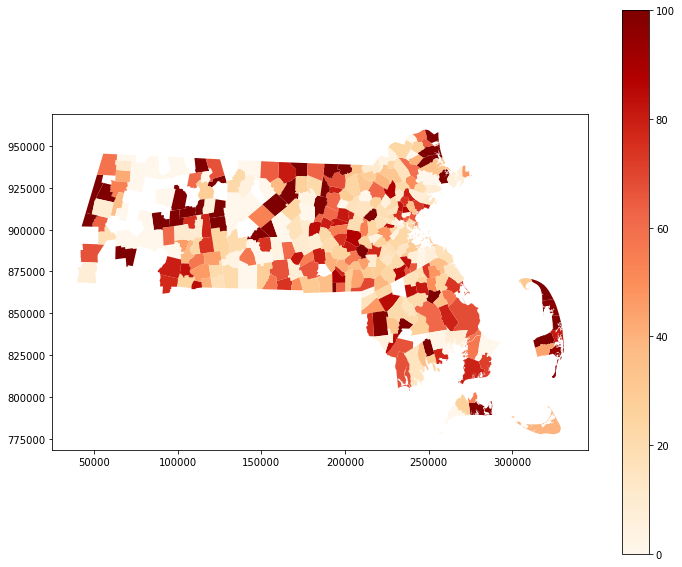

In [192]:
# Group the data by town and calculate the average of the desired columns
town_level_data = lowIn_n_all_school.groupby('Town').agg({
    'Percentage of Low Income Student': 'mean',
    'Percentage of CS Courses Participation': 'mean',
    'County': 'first',
    'geometry': 'first'
}).reset_index()


town_map =gpd.GeoDataFrame(town_level_data)
town_map.plot(figsize=(12,10),colormap='OrRd',column ='Percentage of CS Courses Participation', legend=True)

In [193]:
###create interactive map
new = gpd.read_file('./data/CENSUS2020TOWNS_SHP/CENSUS2020TOWNS_POLY.shp')

new = new.rename(columns={'TOWN20':'Town'})
new['Town'] = new['Town'].str.title()


interactive_map = town_level_data[['Town','Percentage of Low Income Student','Percentage of CS Courses Participation']]
interactive_map = pd.merge(interactive_map, new, how='inner', on='Town')


interactive_map = interactive_map[['Town', 
                                   'Percentage of Low Income Student',
                                   'Percentage of CS Courses Participation',
                                   'COUNTY20',
                                   'geometry']]

interactive_map = interactive_map.rename(columns={'COUNTY20':'County'})
                                                  
interactive_map = gpd.GeoDataFrame(interactive_map)
interactive_map.explore(
    cmap = 'OrRd',
    column = 'Percentage of CS Courses Participation',
    tiles='CartoDB positron',
    style_kwds=dict(color="black")
)

In [194]:
###recap: we can to do quantity analysis first --> group NGO by city and check the number of NGO in one specific city
city_counts = detail_org_data.groupby('city').size().reset_index(name='Number of NGO')

#city_counts['County'] = city_counts['city'].apply(lambda x: town_to_county.get(x.upper()))
city_counts = city_counts.rename(columns={'city':'Town'})
city_counts['Town'] = city_counts['Town'].str.title()

city_counts = pd.merge(city_counts, new, how='inner', on='Town')
city_counts.columns
city_counts = city_counts[['Town','Number of NGO','COUNTY20','geometry']]

city_counts = city_counts.rename(columns={'COUNTY20':'County'})

#city_counts.to_excel('./city.xlsx')

city_counts = gpd.GeoDataFrame(city_counts)


In [195]:
import folium

m = interactive_map.explore(
    cmap = 'OrRd',
    column = 'Percentage of CS Courses Participation',
    legend=True,
    tiles='CartoDB positron',
    style_kwds=dict(color="black"),
    name='Percentage Exposure to CS Literacy'
)

city_counts.explore(
    m=m,  # pass the map object
    cmap = 'OrRd',  # use red color on all points
    tiles='CartoDB positron',
    style_kwds=dict(color="black"),
    column = 'Number of NGO',
    name="Number of NGO",  # name of the layer in the map
)

folium.TileLayer("Stamen Toner", show=False).add_to(
    m
)  # use folium to add alternative tiles
folium.LayerControl().add_to(m)  # use folium to add layer control

m

In [196]:
col = pd.merge(interactive_map, city_counts, how='inner', on='Town')

col = col.drop(columns={'geometry_x', 'geometry_y', 'County_x', 'County_y'})

col.columns

col = col[['Town', 'Percentage of Low Income Student','Number of NGO','Percentage of CS Courses Participation']]

col.to_excel('./ngo_income_expo.xlsx')

In [197]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df is your DataFrame
# df = pd.read_csv('your_file.csv')

# Compute the correlation matrix
corr = col[['Percentage of Low Income Student', 'Number of NGO', 'Percentage of CS Courses Participation']].corr()

corr


,Percentage of Low Income Student,Number of NGO,Percentage of CS Courses Participation
Percentage of Low Income Student,1.000000,0.113512,-0.008597
Number of NGO,0.113512,1.000000,-0.152393
Percentage of CS Courses Participation,-0.008597,-0.152393,1.000000


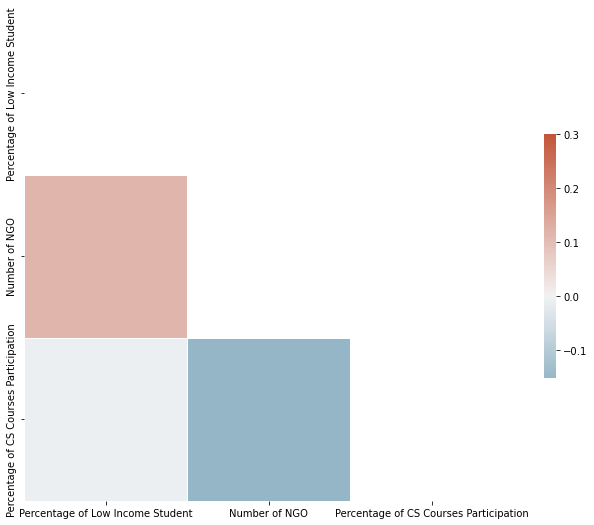

In [198]:
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.show()


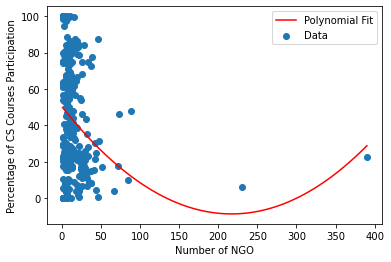

In [199]:
import numpy as np
import matplotlib.pyplot as plt

# Extract the columns from the DataFrame
x = col['Number of NGO']
y = col['Percentage of CS Courses Participation']

# Polynomial Fit
degree = 2  # Change degree depending on how much curvature you expect in the data
coeffs = np.polyfit(x, y, degree)
poly_eqn = np.poly1d(coeffs)

# Create a range of x values for the polynomial equation
x_range = np.linspace(min(x), max(x), 100)
y_range = poly_eqn(x_range)

# Scatter Plot 
plt.scatter(x, y, label='Data')

# Polynomial Regression Line
plt.plot(x_range, y_range, color='red', label='Polynomial Fit')

plt.xlabel('Number of NGO')
plt.ylabel('Percentage of CS Courses Participation')
plt.legend()
plt.show()


In [200]:
import statsmodels.api as sm

# Define the independent variables (X) and the dependent variable (y)
X = col[['Number of NGO', 'Percentage of Low Income Student']]
y = col['Percentage of CS Courses Participation']

# Add a constant to the independent variables matrix
X = sm.add_constant(X)

# Conduct the multiple regression
model = sm.OLS(y, X).fit()

# Print out the results
print(model.summary())


                                      OLS Regression Results                                      
Dep. Variable:     Percentage of CS Courses Participation   R-squared:                       0.023
Model:                                                OLS   Adj. R-squared:                  0.016
Method:                                     Least Squares   F-statistic:                     3.423
Date:                                    Wed, 28 Jun 2023   Prob (F-statistic):             0.0339
Time:                                            14:12:30   Log-Likelihood:                -1425.7
No. Observations:                                     290   AIC:                             2857.
Df Residuals:                                         287   BIC:                             2868.
Df Model:                                               2                                         
Covariance Type:                                nonrobust                                         
          

/Users/vincent/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


In [201]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error

# Set up your variables
X = col[['Number of NGO', 'Percentage of Low Income Student']]
y = col['Percentage of CS Courses Participation']

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Set up your RandomForestRegressor model
rf = RandomForestRegressor(n_estimators=100, random_state=0)

# Train the model
rf.fit(X_train, y_train)

# Predict on test data
y_pred = rf.predict(X_test)

# Evaluate the model
print("R-squared: ", r2_score(y_test, y_pred))
print("RMSE: ", np.sqrt(mean_squared_error(y_test, y_pred)))


R-squared:  -0.47523230893584656
RMSE:  40.71160983361802


In [202]:
ap_performance = pd.read_excel('./data/ap_performance_by_school.xlsx')
ap_performance.columns = ap_performance.iloc[0]
ap_performance = ap_performance[1:]
ap_performance = ap_performance.drop(columns={'Score=1', 'Score=2', 'Score=3', 'Score=4', 'Score=5','% Score 1-2'})
ap_performance = pd.merge(ap_performance, school_detail_info, how='inner', on='School Code')
ap_performance = ap_performance.drop(columns={'School Name'})
ap_performance.head()
ap_performance['County'] = ap_performance['Town'].apply(lambda x: town_to_county.get(x.upper()))


ap_performance['Tests Taken'] = ap_performance['Tests Taken'].str.replace(',', '').str.strip().astype(float)
ap_performance['% Score 3-5'] = ap_performance['% Score 3-5'].fillna(str(0)).str.replace(',', '').str.strip().astype(float)

ap_performance = ap_performance.groupby('Town').agg({
    'Tests Taken': 'mean',
    '% Score 3-5': 'mean',
    'County': 'first'
}).reset_index()

ap_performance = ap_performance.drop(columns='County')
ap_performance = pd.merge(ap_performance,city_counts,how='inner',on='Town')

studpid = ap_performance['geometry']
ap_performance = ap_performance.drop(columns={'geometry'})



Coefficient (slope): -0.014300145497578591
Intercept: 54.97658453504795
R^2: 0.00032150602490521596


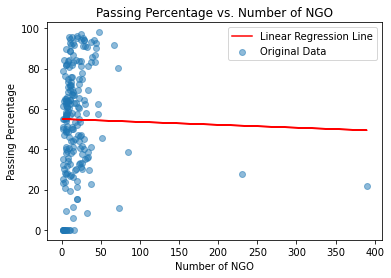

In [203]:
# Extract the columns from the DataFrame
x = ap_performance['Number of NGO']
y = ap_performance['% Score 3-5']

# Reshape the input data
x = np.array(x).reshape(-1, 1)

# Create and fit the linear regression model
model = LinearRegression()
model.fit(x, y)

# Print the coefficients and intercept
print('Coefficient (slope):', model.coef_[0])
print('Intercept:', model.intercept_)

# Predict the output for the input data
y_pred = model.predict(x)

# Calculate the coefficient of determination (R^2)
r2 = model.score(x, y)
print('R^2:', r2)

# Plot the original data and the regression line
plt.scatter(x, y, alpha=0.5, label='Original Data')
plt.plot(x, y_pred, color='red', label='Linear Regression Line')
plt.xlabel('Number of NGO')
plt.ylabel('Passing Percentage')
plt.title('Passing Percentage vs. Number of NGO')
plt.legend()

plt.show()

In [204]:
new = pd.merge(col, ap_performance, how='inner', on='Town')
new = new.drop(columns='Number of NGO_y')
new = new.rename(columns={'Number of NGO_x': 'Number of NGO'})

new = gpd.GeoDataFrame(new, geometry=studpid)

new.explore(
    cmap = 'OrRd'
)
new.head()

,Town,Percentage of Low Income Student,Number of NGO,Percentage of CS Courses Participation,Tests Taken,% Score 3-5,County,geometry
0,Abington,41.470575,7,18.524575,28.0,82.1,PLYMOUTH,"POLYGON ((248314.516 872355.441, 248301.966 87..."
1,Acton,12.786943,28,16.059329,319.0,94.0,MIDDLESEX,"POLYGON ((209455.542 917109.043, 209452.756 91..."
2,Agawam,49.680680,8,24.217660,37.0,48.6,HAMPDEN,"POLYGON ((109952.288 871999.545, 109955.233 87..."
3,Amesbury,41.529880,17,56.611720,30.0,53.3,ESSEX,"POLYGON ((248713.789 953867.270, 248652.758 95..."
4,Amherst,37.341220,39,77.789960,85.0,85.9,HAMPSHIRE,"POLYGON ((119026.200 906796.569, 119201.971 90..."


Coefficient (slope): -0.77111604886958
Intercept: 83.3178208806732
R^2: 0.3776406091575307


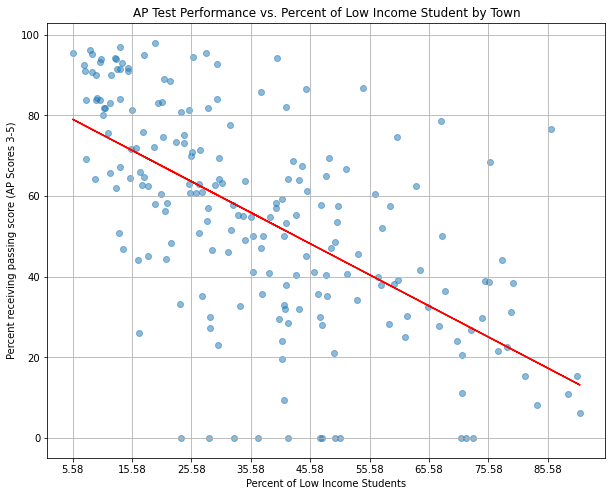

In [215]:
# Extract the columns from the DataFrame
x = new['Percentage of Low Income Student']
y = new['% Score 3-5']

# Reshape the input data
x = np.array(x).reshape(-1, 1)

# Create and fit the linear regression model
model = LinearRegression()
model.fit(x, y)

# Print the coefficients and intercept
print('Coefficient (slope):', model.coef_[0])
print('Intercept:', model.intercept_)

# Predict the output for the input data
y_pred = model.predict(x)

# Calculate the coefficient of determination (R^2)
r2 = model.score(x, y)
print('R^2:', r2)

# Set the figure size (width=10, height=8) and plot the original data and the regression line
plt.figure(figsize=(10, 8))  # Here you can change the figure size as you like
plt.scatter(x, y, alpha=0.5, label='Original Data')
plt.plot(x, y_pred, color='red', label='Linear Regression Line')
plt.xticks(np.arange(min(x), max(x)+1, 10))
plt.xlabel('Percent of Low Income Students')
plt.ylabel('Percent receiving passing score (AP Scores 3-5)')
plt.title('AP Test Performance vs. Percent of Low Income Student by Town')
plt.grid()
plt.show()
